In [91]:
from PIL import Image, ImageFilter, ImageOps
from PIL.ImageFilter import (
     BLUR, CONTOUR, EDGE_ENHANCE, EDGE_ENHANCE_MORE,
     EMBOSS, FIND_EDGES, SHARPEN
)
from PIL.Image import Transpose, Transform
import numpy as np

In [2]:
filename= 'image.jpg'

In [3]:
with Image.open(filename) as img:
    img.load()

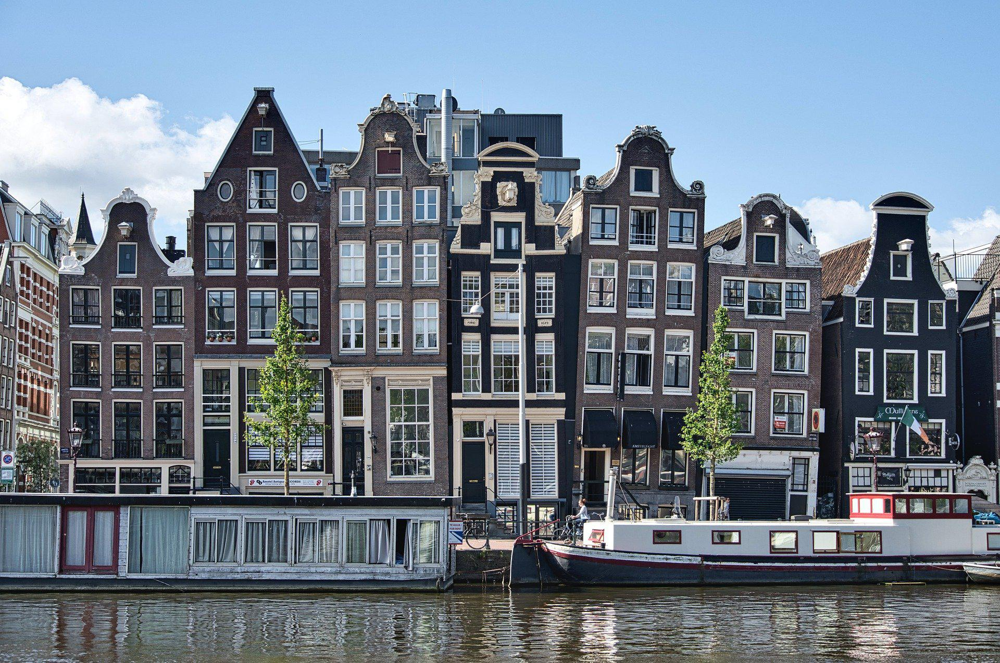

In [4]:
display(img)

In [5]:
# Lam ro net hinh anh
def sharpenPic(current_img: Image):
    return current_img.filter(SHARPEN)

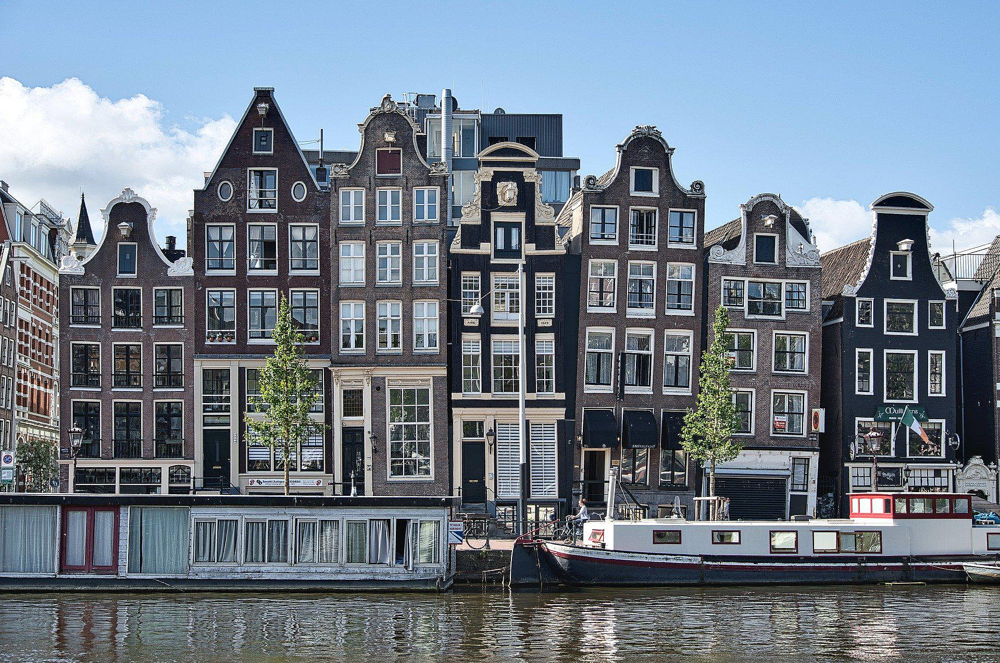

In [6]:
display(sharpenPic(img))

In [7]:
# Làm mờ ảnh bằng filter mặc định BLUR
def blurPic(current_img: Image):
    return current_img.filter(BLUR)

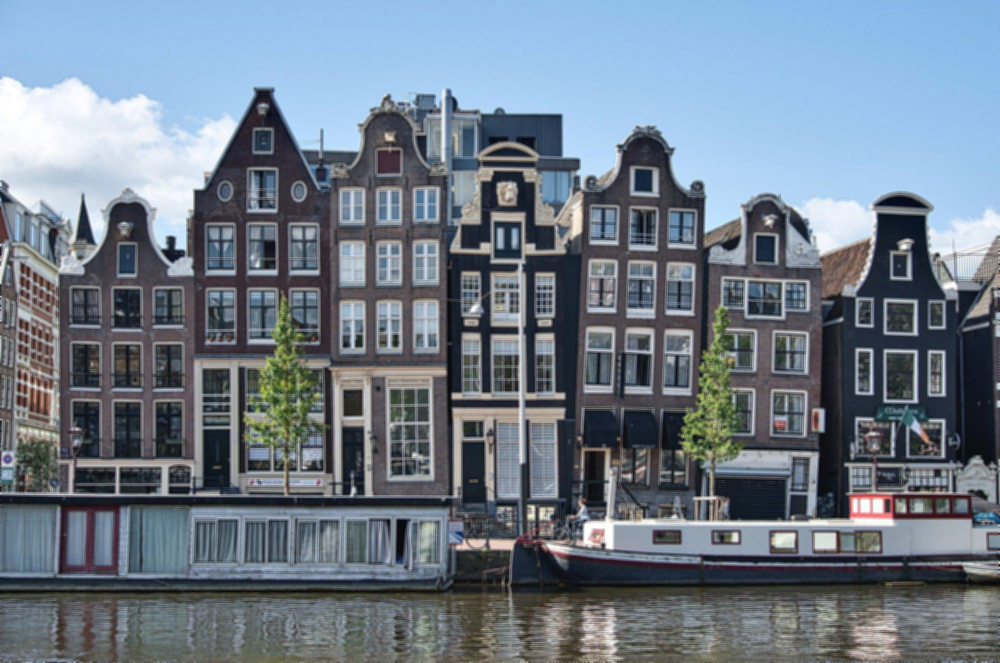

In [8]:
display(blurPic(img))

In [9]:
# Làm mờ ảnh tốt hơn với GaussianBlur
def betterBlurPic(current_img: Image, radius: int = 20):
    return current_img.filter(ImageFilter.GaussianBlur(radius))

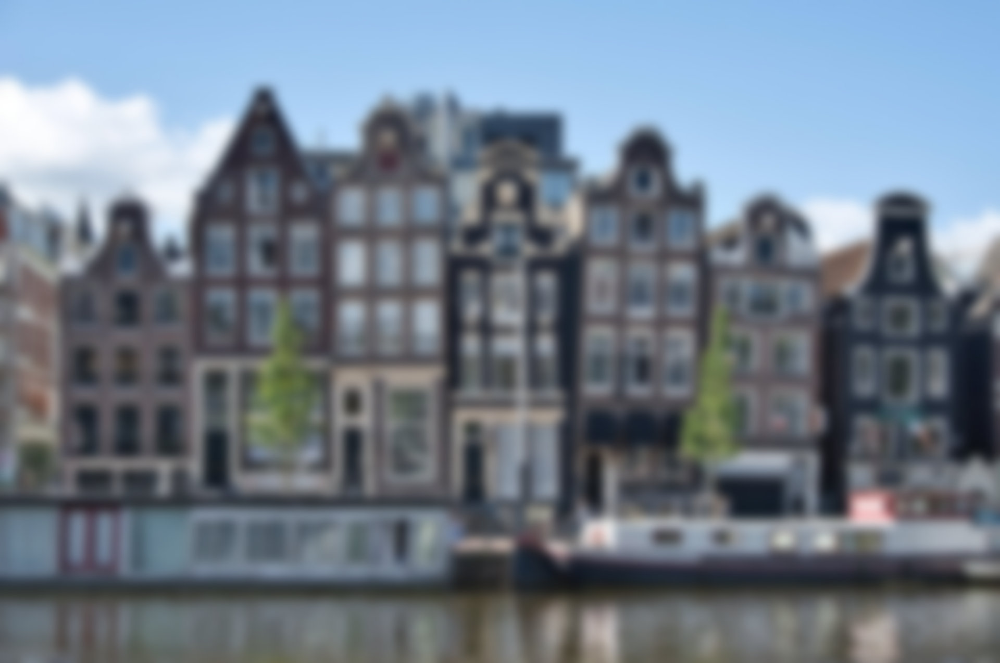

In [10]:
display(betterBlurPic(img,10))

## Filters

In [11]:
def sketchPic(current_img: Image):
    return current_img.filter(CONTOUR)

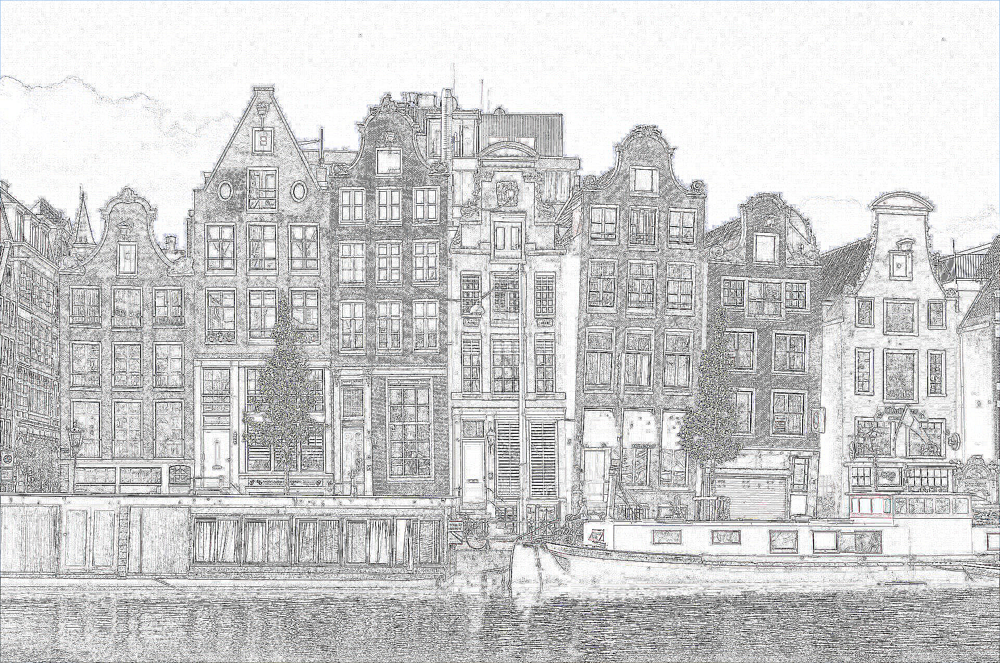

In [12]:
display(sketchPic(img))

In [13]:
def pencilPic(current_img: Image):
    return current_img.filter(EDGE_ENHANCE_MORE)


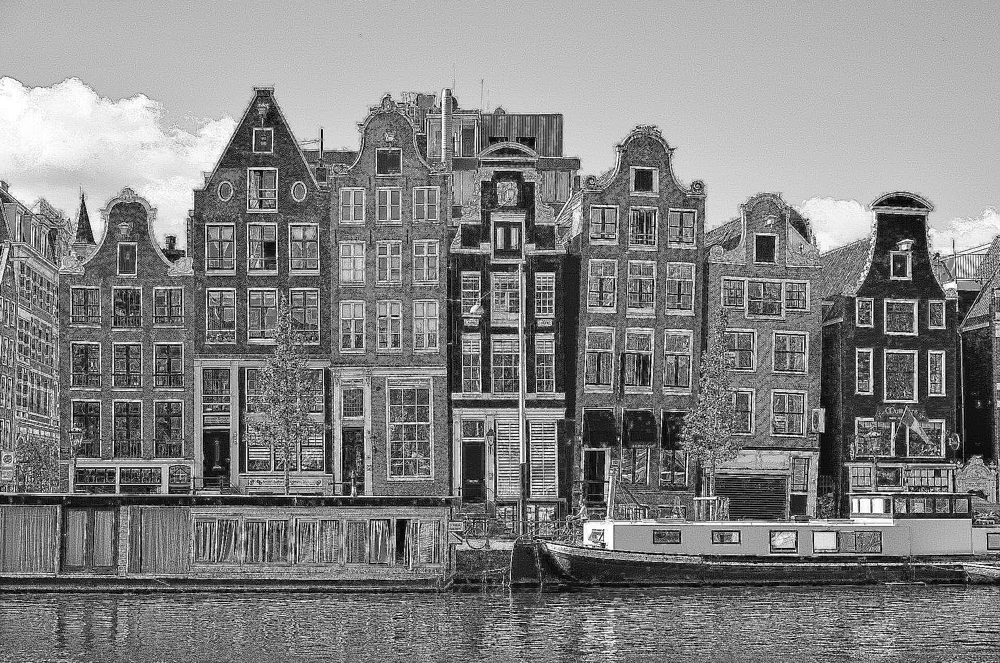

In [14]:
pencil_img = pencilPic(img.convert("L"))
display(pencil_img)

## Find edges

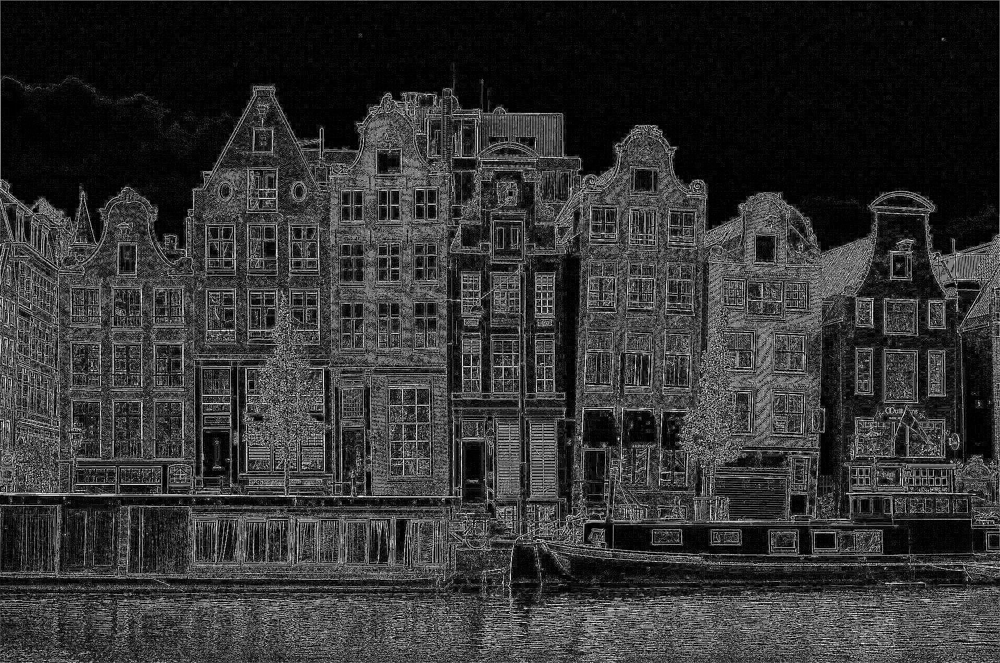

In [15]:
edges = img.filter(ImageFilter.FIND_EDGES)
bands = edges.split()
bands[0]

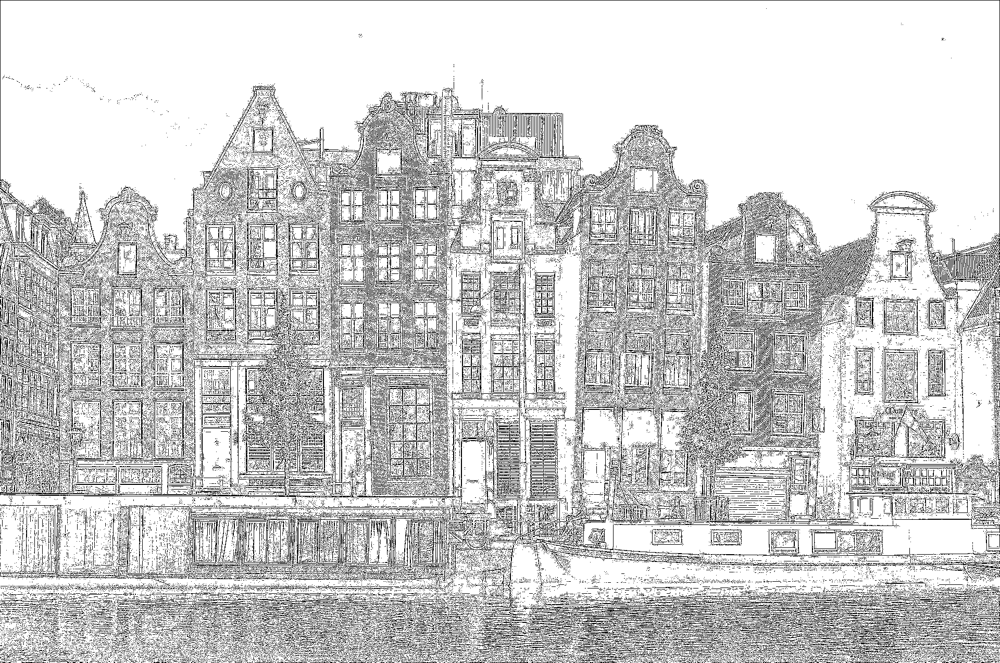

In [16]:
# Invert the color (Black -> White, White -> Black)
outline = bands[0].point(lambda x: 255 if x < 100 else 0)
outline

## Get image infomation

In [17]:
img.info

{'jfif': 257,
 'jfif_version': (1, 1),
 'jfif_unit': 0,
 'jfif_density': (1, 1),
 'progressive': 1,
 'progression': 1}

In [18]:
outline.getbands()

('L',)

## Image Thresholding

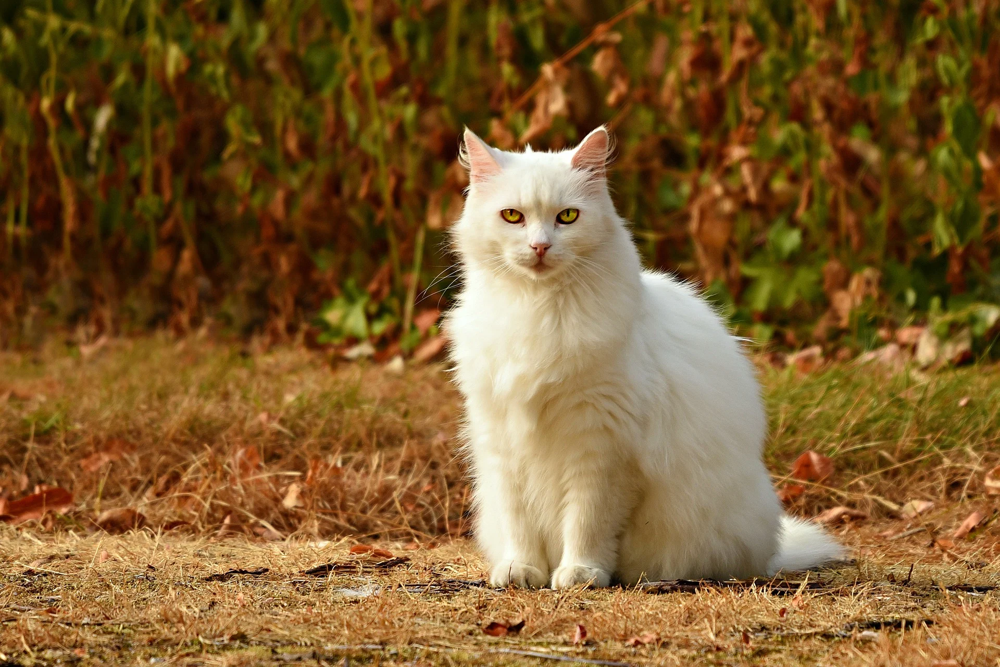

In [19]:
with Image.open('cat.jpg') as cat_img:
    cat_img.load()
cat_img

In [20]:
cat_img.format

'WEBP'

### You’ll need to remove the picture of the cat from the background

1. Crop the image

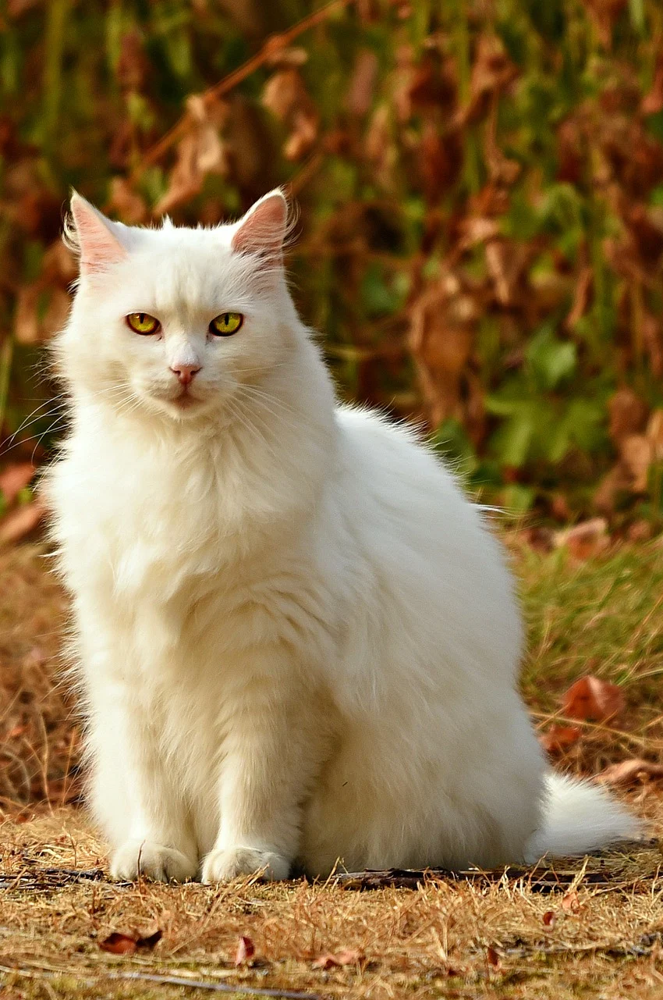

In [21]:
cat_img = cat_img.crop((800, 0, 1650, 1281))
cat_img

Each pixel in a color image is represented digitally by three numbers corresponding to the red, green, and blue values of that pixel. Thresholding is the process of converting all the pixels to either the maximum or minimum value depending on whether they’re higher or lower than a certain number. It’s easier to do this on a grayscale image:

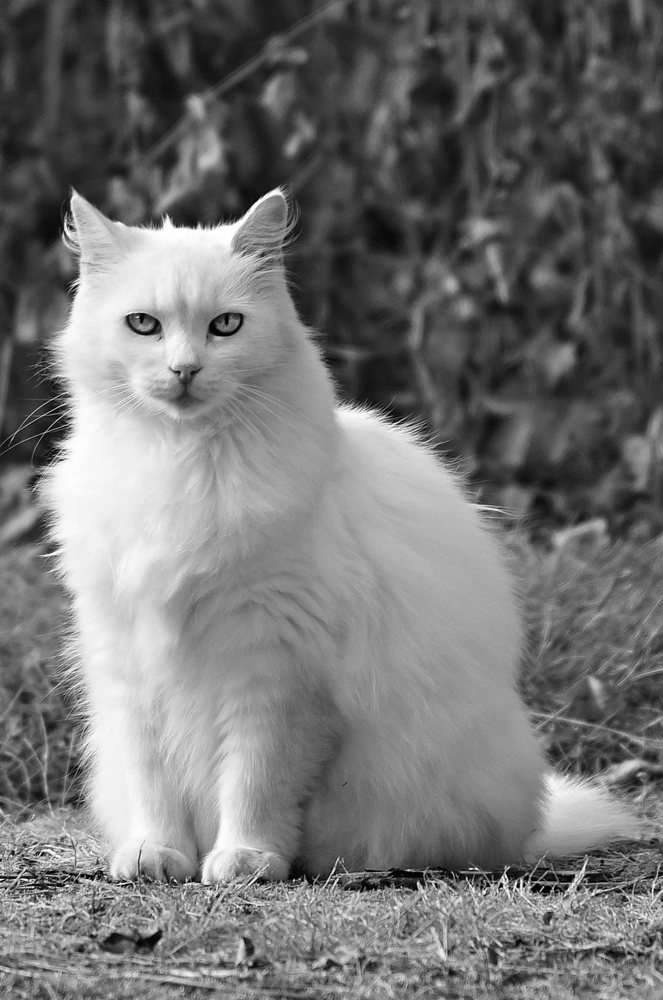

In [173]:
cat_img_gray = cat_img.convert('L')
cat_img_gray

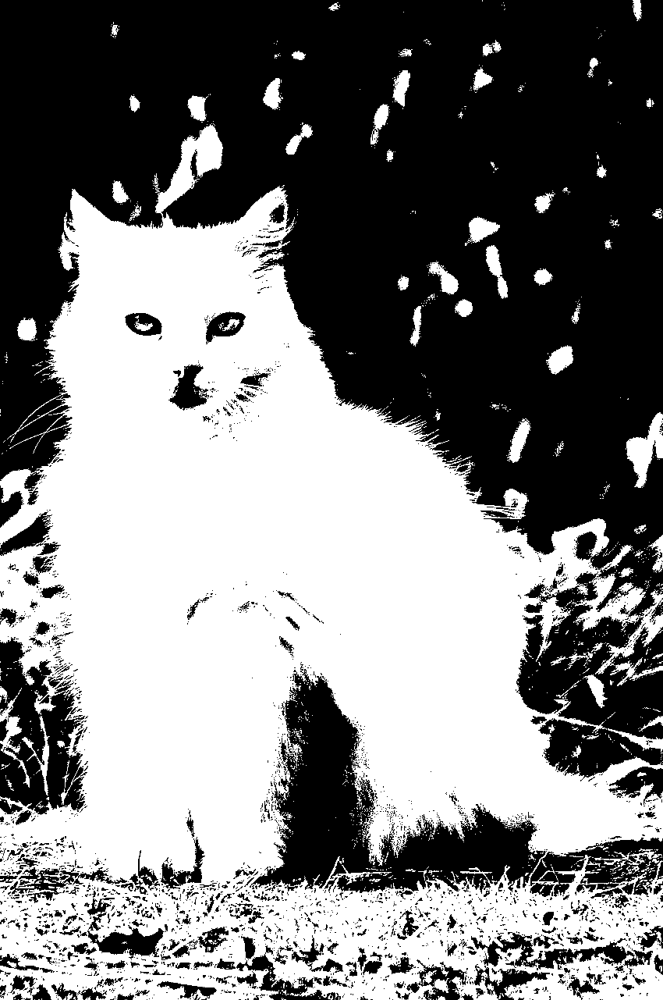

In [23]:
# Define threshold (Ngưỡng)
threshold = 110
cat_img_threshold = cat_img_gray.point(
    lambda x: 255 if x > threshold else 0
)
cat_img_threshold

In [24]:
# Dilation (Giản nở ảnh)
def delate(cycles: int, img: Image):
    for _ in range(cycles):
        img = img.filter(ImageFilter.MaxFilter(size=3))
    return img

# Erosion (Co ảnh)
def erode(cycles: int, img: Image):
    for _ in range(cycles):
        img = img.filter(ImageFilter.MinFilter(size=3))
    return img

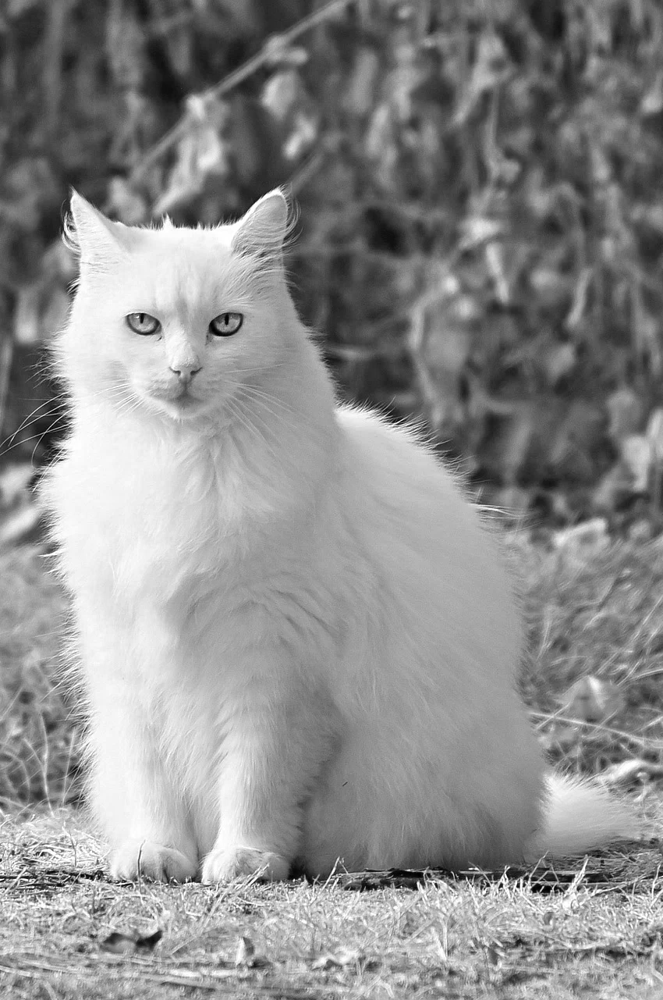

In [106]:
# Split image into 3 color band
red, green, blue = cat_img.split()
red

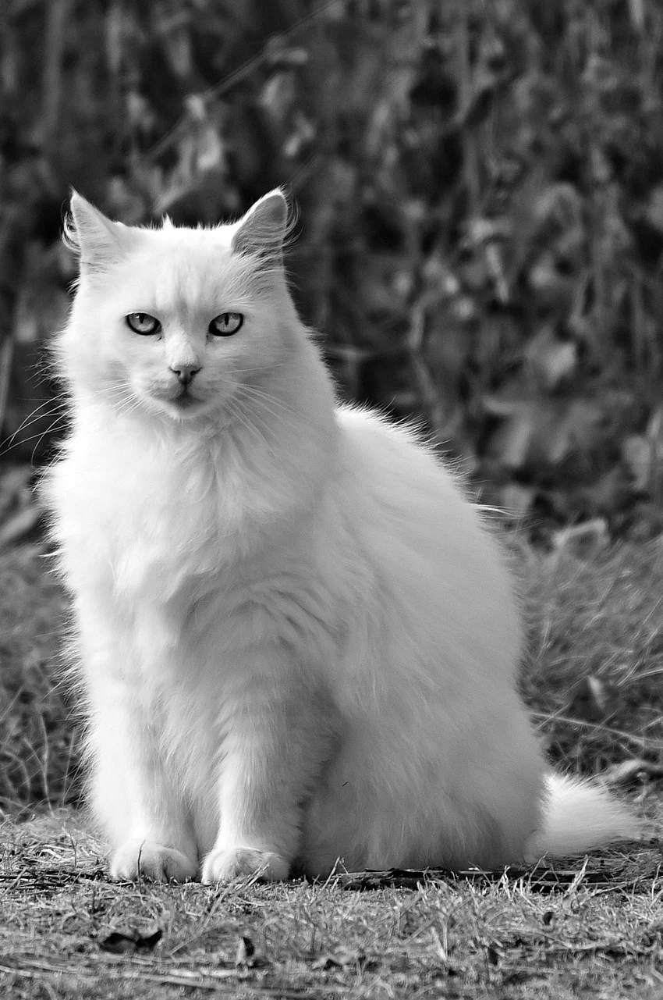

In [107]:
green

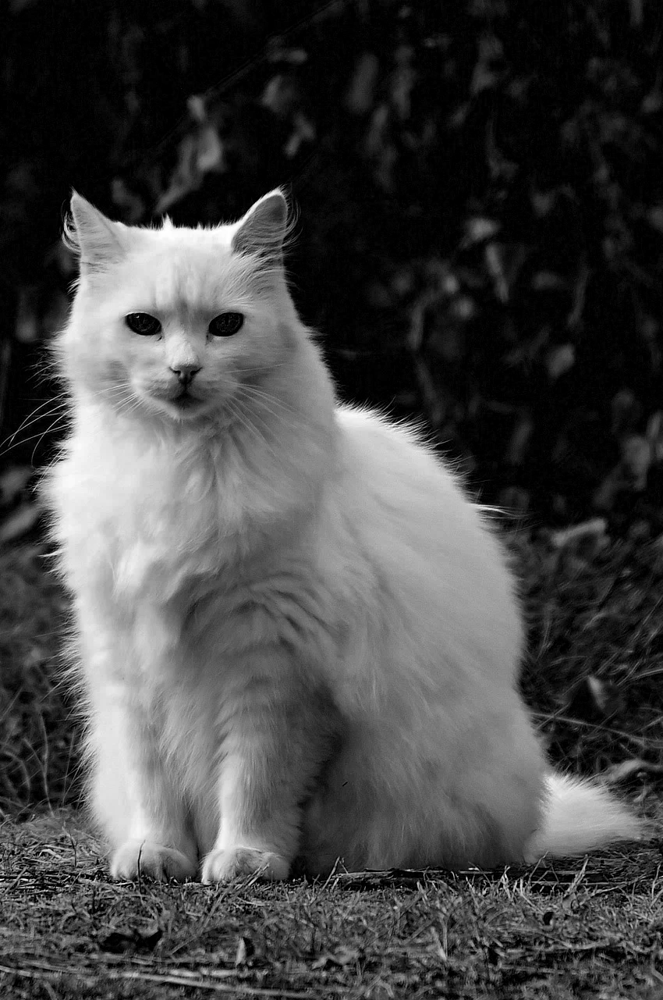

In [108]:
blue

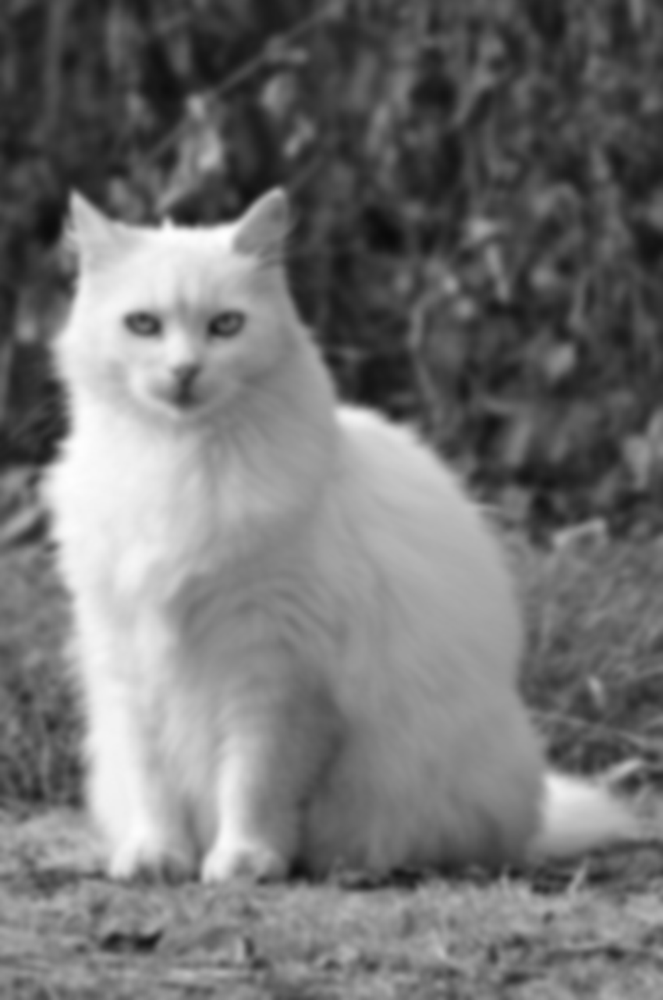

In [160]:
# blue = blue.filter(ImageFilter.GaussianBlur(3))
# cat_img_gray = cat_img_gray.filter(ImageFilter.GaussianBlur(3))
cat_img_gray

In [110]:
def Tim_nguong_toan_cuc(img): # Định nghĩa hàm tìm ngưỡng
    #Bước 1. Khởi tạo ngưỡng ban đầu t bằng giá trị trung bình mức xám của ảnh
    t=np.mean(img) #initial condition
    g1 = []  # Định nghĩa nhóm g1
    g2 = []  # Định nghĩa nhóm g2
    m,n = img.shape
    # Lặp để tính ngưỡng
    while (True):
        # Bước 2. Tạo nhóm g1,g2 dựa trên ngưỡng t
        for i in range(m):
            for j in range(n):
                if (img[i,j] < t):
                    g1.append(img[i,j])
                else:
                    g2.append(img[i,j])
        # Bước 3. Tính trung bình mức xám trong vùng g1,g2
        mu1 = np.mean(g1)
        mu2 = np.mean(g2)
        # Bước 4. Tính lại ngưỡng t có giá trị mới
        t = ((mu1+ mu2)/2)
        # Tính delta t để làm điều kiện thoát vòng lặp
        t0 = t
        delta_t = abs(t-t0)
        if(delta_t < 1):
            break
    print("Ngưỡng tìm được: ",t)
    return t

In [174]:
Tim_nguong_toan_cuc(np.array(cat_img_gray))

Ngưỡng tìm được:  118.05657690409473


118.05657690409473

In [122]:
int(78.17550430161306)

78

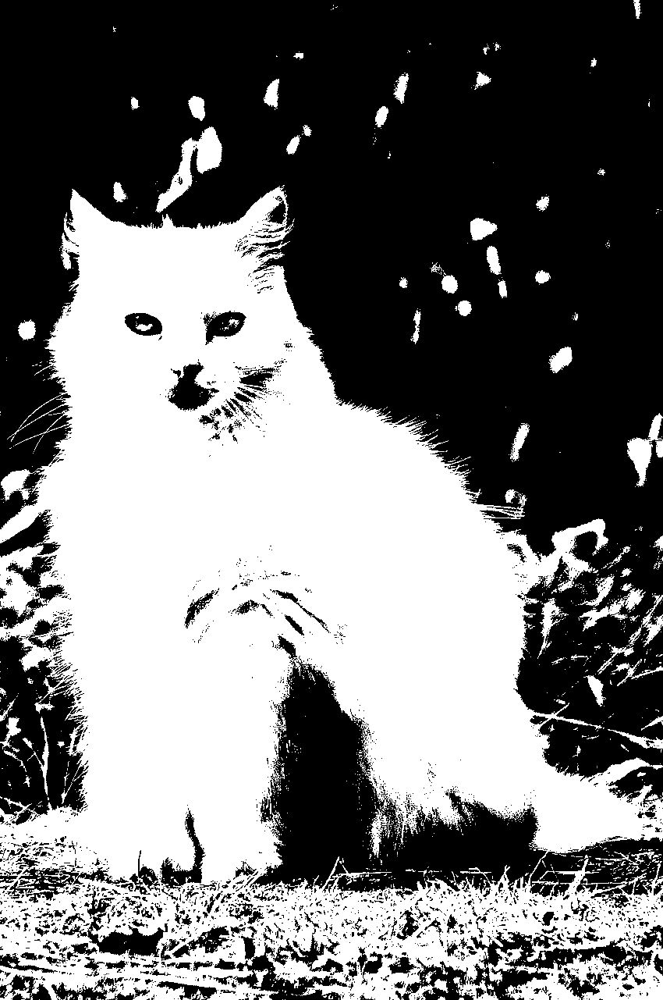

In [175]:
# blue band have highest contrast between the pixels representing the cat and those representing the background.
threshold = 118
cat_img_threshold = cat_img_gray.point(
    lambda x: 255 if x > threshold else 0
)
cat_img_threshold

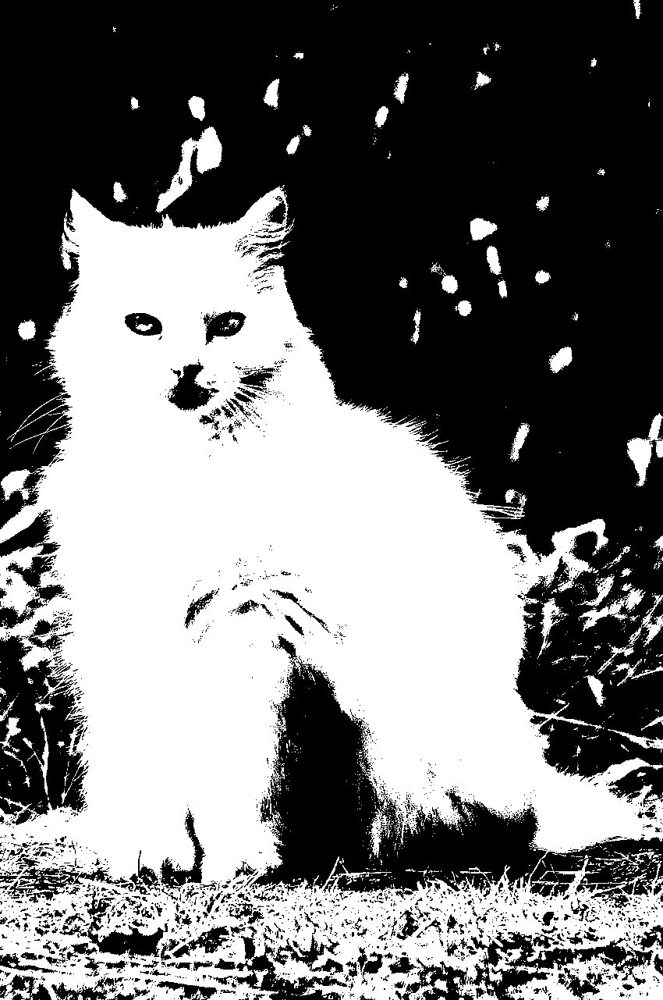

In [176]:
cat_img_threshold = cat_img_threshold.convert("1")
cat_img_threshold

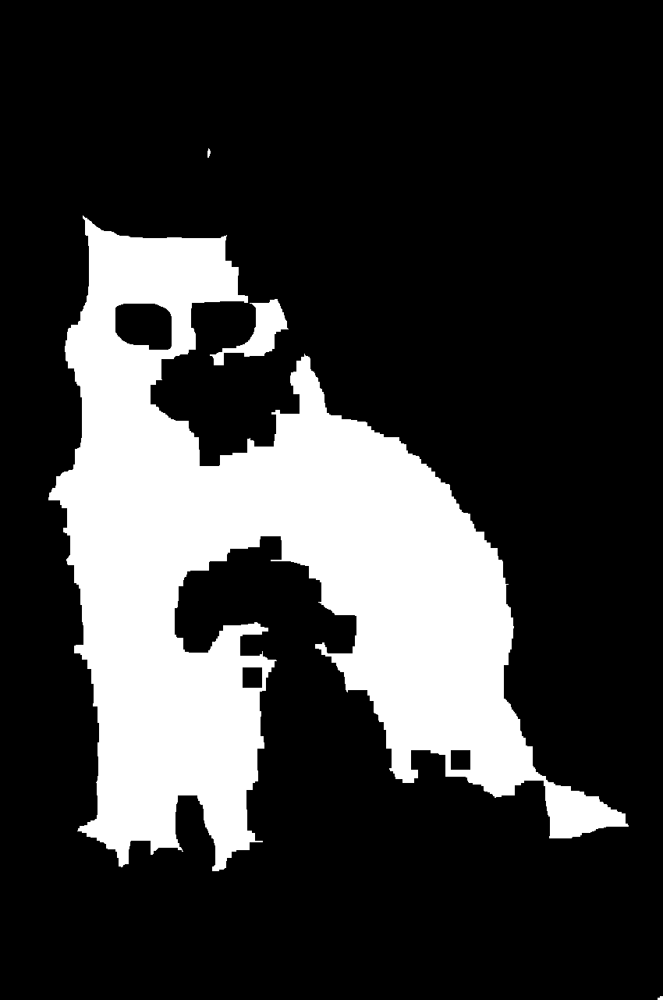

In [177]:
step_1 = erode(12, cat_img_threshold)
step_1

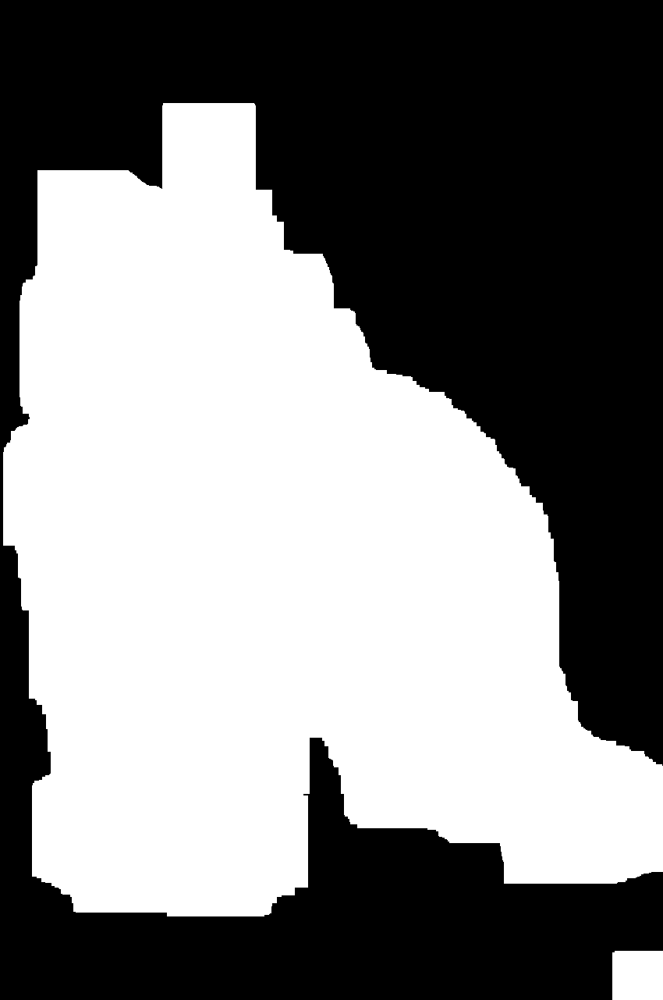

In [178]:
step_2 = delate(58, step_1)
step_2

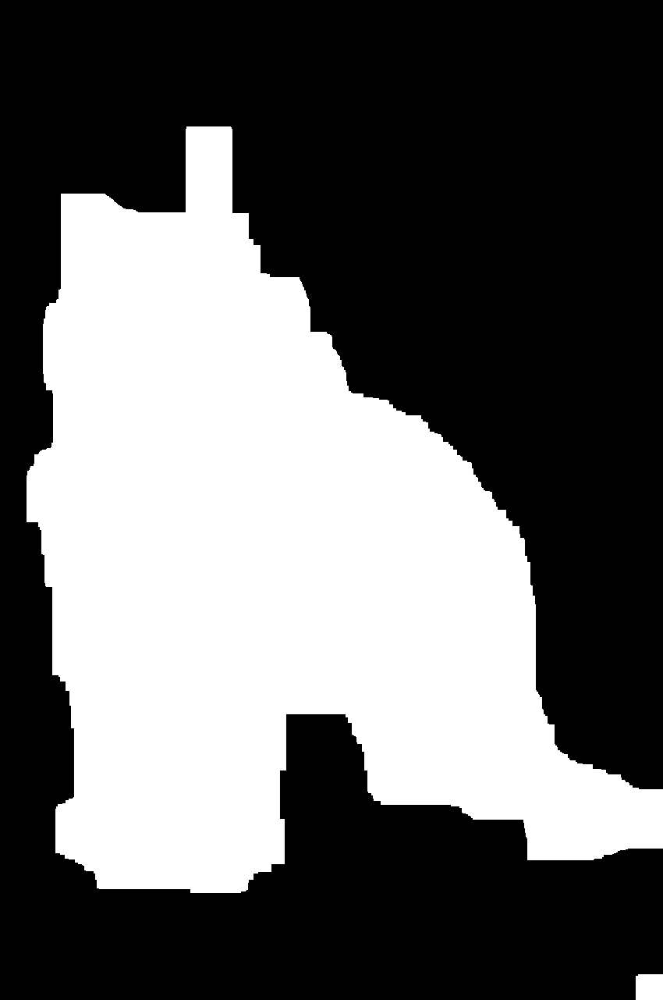

In [185]:
cat_mask = erode(30, step_2)
cat_mask

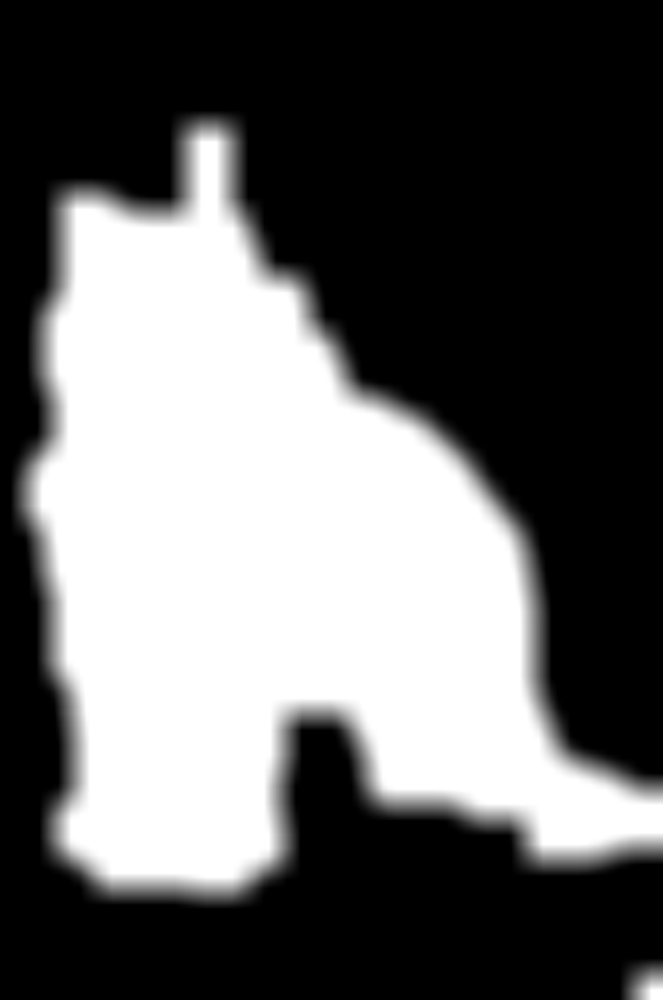

In [186]:
# Avoid the sharp edges of binary mask
cat_mask = cat_mask.convert("L")
cat_mask = cat_mask.filter(ImageFilter.BoxBlur(20))
cat_mask

### Extract image 

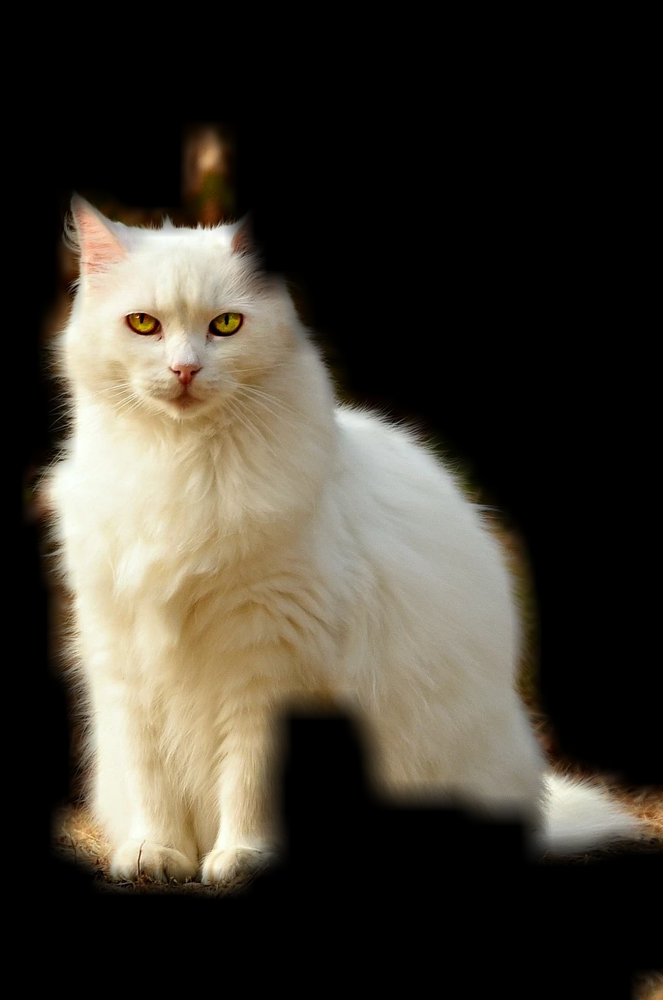

In [181]:
blank = cat_img.point(lambda _: 0)
cat_segmented = Image.composite(cat_img, blank, cat_mask)
cat_segmented

## Brighten Image

In [182]:
original_pixels = img.load()

In [183]:
img_width, img_height = img.width, img.height

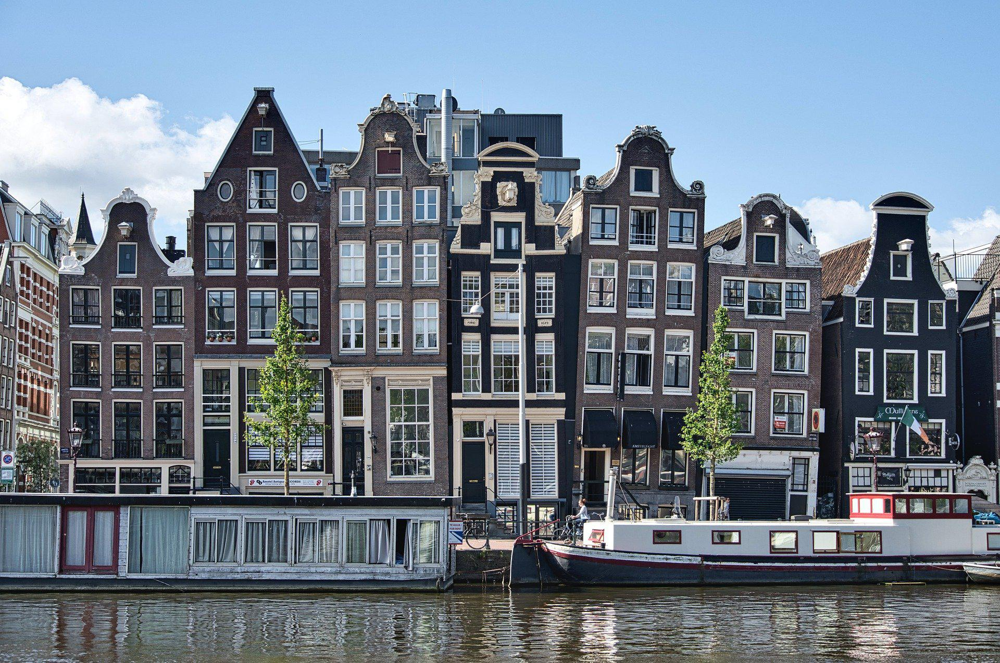

In [184]:
brightness_factor = 1
for x in range(img_width):
    for y in range(img_height):
        ori_pixel = original_pixels[x, y]
        r, g, b = ori_pixel
        
        new_r = int(r * brightness_factor)
        new_g = int(g * brightness_factor)
        new_b = int(b * brightness_factor)
        
        ori_pixel = (new_r, new_g, new_b)
        original_pixels[x, y] = ori_pixel
        
img